## How to submit to Kaggle

This notebook will walk you through a linear regression model using two variables to submit to Kaggle.

In [30]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

In [96]:

from sklearn.model_selection import train_test_split
from sklearn.linear_model import ElasticNet, LinearRegression, RidgeCV, LassoCV, ElasticNetCV
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import ShuffleSplit
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import learning_curve
from sklearn.svm import SVC
from sklearn.model_selection import validation_curve
from sklearn.metrics import mean_squared_error
import warnings
warnings.filterwarnings("ignore")

You'll need both `train.csv` and `test.csv`:

In [6]:
df = pd.read_csv('../datasets/clean_train_data.csv')

In [7]:
test = pd.read_csv('../datasets/clean_test_data.csv')

In [8]:
df.head(3)

,Id,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Lot Shape,Land Contour,Utilities,...,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Misc Val,Mo Sold,Yr Sold,Sale Type,SalePrice,totalLivingSF
0,109,533352170,60,RL,69.0483,13517,Pave,IR1,Lvl,AllPub,...,0,0,0,0,0,3,2010,WD,130500,2204.0
1,544,531379050,60,RL,43.0000,11492,Pave,IR1,Lvl,AllPub,...,0,0,0,0,0,4,2009,WD,220000,3035.0
2,153,535304180,20,RL,68.0000,7922,Pave,Reg,Lvl,AllPub,...,0,0,0,0,0,1,2010,WD,109000,2114.0


Let's use `Overall Qual` and `Gr Liv Area` to build our model:

In [442]:
#df.corr()['SalePrice'].sort_values(ascending=True)

In [9]:
df.head()

,Id,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Lot Shape,Land Contour,Utilities,...,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Misc Val,Mo Sold,Yr Sold,Sale Type,SalePrice,totalLivingSF
0,109,533352170,60,RL,69.0483,13517,Pave,IR1,Lvl,AllPub,...,0,0,0,0,0,3,2010,WD,130500,2204.0
1,544,531379050,60,RL,43.0000,11492,Pave,IR1,Lvl,AllPub,...,0,0,0,0,0,4,2009,WD,220000,3035.0
2,153,535304180,20,RL,68.0000,7922,Pave,Reg,Lvl,AllPub,...,0,0,0,0,0,1,2010,WD,109000,2114.0
3,318,916386060,60,RL,73.0000,9802,Pave,Reg,Lvl,AllPub,...,0,0,0,0,0,4,2010,WD,174000,1828.0
4,255,906425045,50,RL,82.0000,14235,Pave,IR1,Lvl,AllPub,...,0,0,0,0,0,3,2010,WD,138500,2121.0


In [10]:
df.corr()['SalePrice'].sort_values(ascending=False)[:10]

SalePrice         1.000000
Overall Qual      0.797464
totalLivingSF     0.781714
Gr Liv Area       0.695185
Garage Area       0.648543
Garage Cars       0.645511
Total Bsmt SF     0.623746
1st Flr SF        0.616027
Year Built        0.564084
Year Remod/Add    0.542661
Name: SalePrice, dtype: float64

Defining `X` and `y`:

In [11]:
features = ['Overall Qual', 'Fireplaces', 'Gr Liv Area', 'Year Built']
X = df[features]
y = df['SalePrice']

Train-test split:

In [12]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 42)

Intialize, fit, and evaluate the model:

In [13]:
lr = LinearRegression()

lr.fit(X_train, y_train)
lr.score(X_train, y_train), lr.score(X_test, y_test)

(0.7429405345635641, 0.7912767471560127)

Nice! The model is scoring well enough on the test set that I'm comfortable using it to make predictions on more unseen data.

This next line of code won't work. Let's see why:

In [72]:
#lr.predict(test)

    `ValueError: could not convert string to float: 'WD '`

This is happening because we're trying to predict on the whole dataframe, rather than on the two variables we subsetted on for `X`. Compare the below:

In [14]:
test.shape

(879, 96)

In [15]:
X.shape

(2028, 4)

`test` will need to have the _exact same columns_ as `X` in order for our model to work.

I'll subset `test` with the list `features` that I saved above:

In [16]:
test_subset = test[features]
test_subset.head()

,Overall Qual,Fireplaces,Gr Liv Area,Year Built
0,6,0,1928,1910
1,5,0,1967,1977
2,7,1,1496,2006
3,5,0,968,1923
4,6,2,1394,1963


Now I can store predictions:

In [17]:
preds = lr.predict(test_subset)
preds[0:4]

array([160830.24481521, 173939.00649302, 226540.68811341,  91609.9487188 ])

Of course, we can't score the model on our own computers; we don't have access to the true value of `y` for `test`. We need to upload our predictions to Kaggle so that it can calculate the RMSE.

Kaggle will expect a very specific csv file: one row for every observation, and two columns with the names `Id` and `SalePrice`. The `Id` column should contain the house ID associated with our predicted sale price. One way to export the csv file would be this:

In [107]:
lasso_submit = pd.DataFrame({
    'Id': test['Id'],
    'SalePrice': lcv.predict(test)
})

ValueError: could not convert string to float: 'Pave'

Here, we have a dataframe with appropriately labeled columns:

In [20]:
to_submit.head()

,Id,SalePrice
0,2658,160830.244815
1,2718,173939.006493
2,2414,226540.688113
3,1989,91609.948719
4,625,188062.525437


Export to csv:

In [410]:
to_submit.to_csv('submissions.csv', index=False)

Note: Setting `index = False` keeps the indices from being exported as well. **Kaggle will not accept a csv file that contains the indices.**

Good luck!

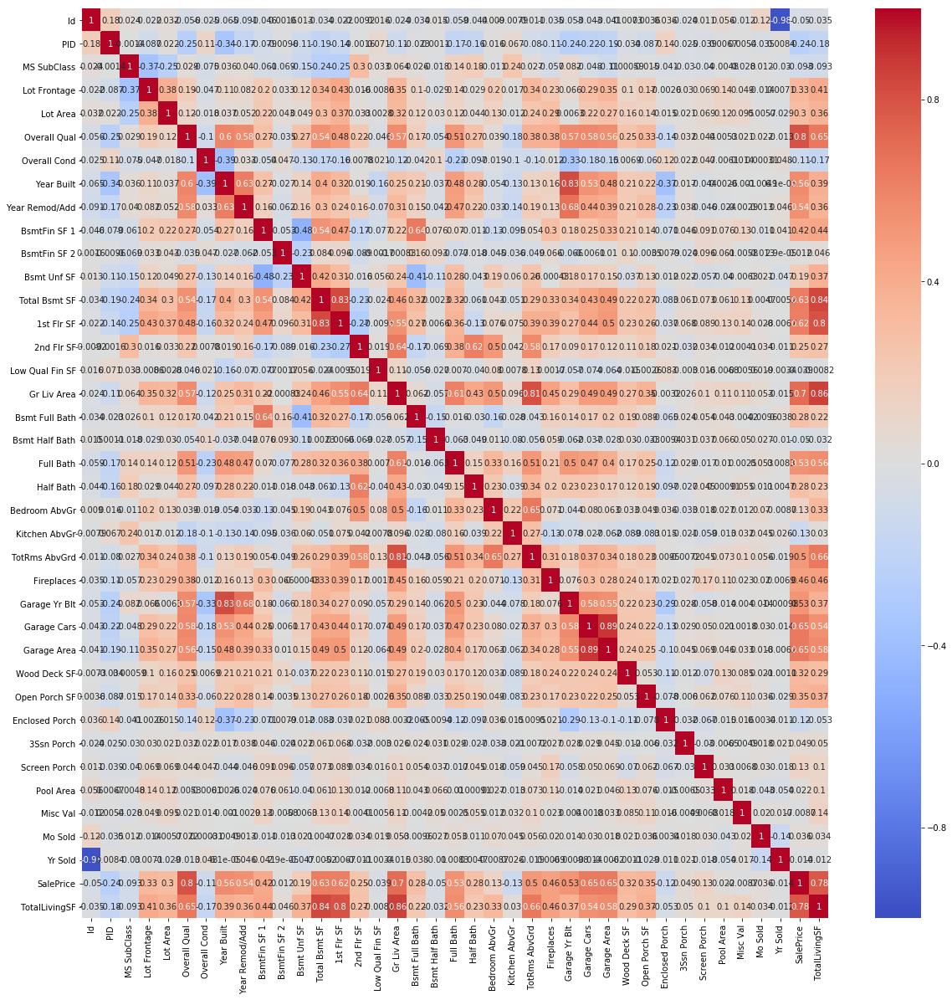

In [176]:
plt.figure(figsize=(20 ,20))
sns.heatmap(df.corr(), annot=True, vmin=-1, vmax=1, cmap='coolwarm');

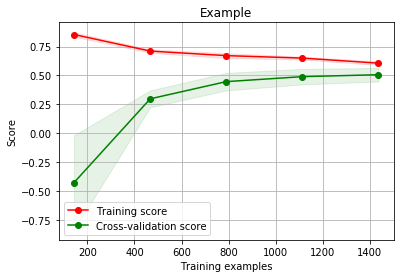

In [528]:
#plot_learning_curve(lr,'Example', X, y, cv=5,n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5));

In [529]:
lr.score(X_train,y_train)

0.7490554777007177

In [530]:
lr.score(X_test, y_test)

0.7892798584730554

/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


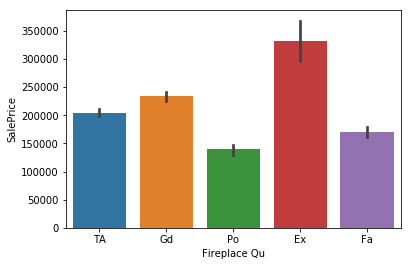

In [531]:
sns.barplot(df['Fireplace Qu'],df['SalePrice']);

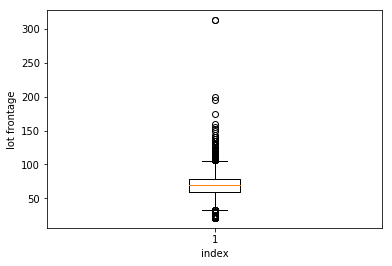

In [41]:
#thinking about removing that outlier.

plt.boxplot(df['Lot Frontage'])
plt.xlabel('index')
plt.ylabel('lot frontage');

In [45]:
X_train,X_test, y_train,y_test= train_test_split(X,y, random_state=42)

In [97]:
ss= StandardScaler()
ss.fit(X_train)
X_train_s=ss.transform(X_train)
X_test_s=ss.transform(X_test)

In [47]:
lr=LinearRegression()

In [87]:
# cross_val_score(lr,X_train_s, y_train,cv=3).mean()

In [48]:
lr.fit(X_train_s,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [100]:
lr.score(X_train_s,y_train), lr.score(X_test_s,y_test) #this is good 

(0.7429405345635641, 0.7912767471560122)

In [101]:
np.sqrt(mean_squared_error(y, lr.predict(X))) 

39956.17506648421

In [102]:
#finding optimal value for Lasso Regression
lcv=LassoCV(cv=3, max_iter=10000)

lcv.fit(X_train_s,y_train)

LassoCV(alphas=None, copy_X=True, cv=3, eps=0.001, fit_intercept=True,
    max_iter=10000, n_alphas=100, n_jobs=None, normalize=False,
    positive=False, precompute='auto', random_state=None,
    selection='cyclic', tol=0.0001, verbose=False)

In [103]:
lcv.alpha_ #this is my budget (but you don't do anything with this. Just make sure it is
           #between the min and max) 

62.10745763057999

In [94]:
# the biggest alpha we tested:
max(lcv.alphas_)

62107.45763057996

In [95]:
# the smallest alpha we tested:
min(lcv.alphas_)

62.10745763057999

In [54]:
# cross validate lass r^2 with the optimal alpha
cross_val_score(lcv, X_train_s,y_train)

/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:1943: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


array([0.76365823, 0.69066444, 0.74609474])

In [104]:
lcv.score(X_test_s, y_test)

0.7912425825631267

In [105]:
lcv.score(X_train_s, y_train)

0.7429393384196501

In [106]:
np.sqrt(mean_squared_error(y, lcv.predict(X))) 

39956.26802800959

In [108]:
coefs = pd.DataFrame({
    'variable':X.columns,
     'coef' :lcv.coef_
}).set_index('variable').head(25)

AttributeError: 'numpy.ndarray' object has no attribute 'columns'

In [109]:
lcv.coef_

array([34096.86207106,  8789.89662551, 27261.3390206 , 15722.99310625])

In [459]:
coefs

,coef
variable,
Overall Qual,32048.156479
Fireplaces,7844.560647
Gr Liv Area,10715.803960
totalLivingSF,22495.353183
Year Built,12005.828318


In [533]:
# Leave it be
df[df['Lot Frontage'] > 150]

,Id,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,...,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,SalePrice
191,2119,906475170,20,RL,155.0,20064,Pave,NaN,IR1,Low,...,0,0,NaN,NaN,NaN,0,5,2007,WD,279000
441,1639,527226040,190,RL,195.0,41600,Pave,NaN,IR1,Lvl,...,0,0,NaN,NaN,NaN,0,11,2007,WD,155000
960,1499,908154235,60,RL,313.0,63887,Pave,NaN,IR3,Bnk,...,0,480,Gd,NaN,NaN,0,1,2008,New,160000
1224,1631,527175130,20,RL,160.0,18160,Grvl,NaN,Reg,Lvl,...,0,0,NaN,MnPrv,NaN,0,3,2007,WD,154204
1263,496,528321010,60,RL,174.0,15138,Pave,NaN,IR1,Lvl,...,0,0,NaN,NaN,NaN,0,7,2009,WD,403000
1335,1266,535427070,20,RL,313.0,27650,Pave,NaN,IR2,HLS,...,0,0,NaN,NaN,NaN,0,11,2008,WD,242000
1875,2279,923202220,20,RL,200.0,43500,Pave,NaN,Reg,Lvl,...,0,561,TA,GdPrv,NaN,0,6,2007,WD,130000
1952,2690,903430130,30,RM,153.0,4118,Pave,Grvl,IR1,Bnk,...,0,0,NaN,NaN,NaN,0,3,2006,WD,52500


In [534]:
def mean_prices_categorical_var(df):
    for i in df:
        if df[i].dtype == 'O':
            print(df.groupby(i, as_index=True)['SalePrice'].mean() )  
            print("\n")
      
    print(mean_prices_categorical_var(df))

In [ ]:
mean_prices_categorical_var(df)

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.57055

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167


Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.00

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
W

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    1

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Gara

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.22222

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
Gas

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgC

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Gara

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Na

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      2418

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
Gas

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWA


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgC

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
Gas

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
W

Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    1

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    1

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
W

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      2418

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.00

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gam

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
Gas

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    18922

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      2418

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWA

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      2418

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ  

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
Gas

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   



Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.2222

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal    

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.33

Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64



Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    

Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64



Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         2186


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gam

Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ  

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
Gas

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
Pos

Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SaleP

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr



Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64



Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
M

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.33

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64



MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
M

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgC

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Na

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gam

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279



House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing  

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.



Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal    

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal    

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         2186

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal    

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
M

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Gara

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         2186

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    



Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Q

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal    

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Gara

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64



Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Na

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWA

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 



Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave 

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
M

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name:

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ  

Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      2418

Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgC

Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         2186

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835

Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f



BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dt


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa   

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    

Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
Pos

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal    

Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
W

Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         2186

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


E

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Gara

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Na

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.33

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ  

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      19820

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal    

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.00

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
M

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
W

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.33

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515



Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa  

Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgC

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgC

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Gara

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWA

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.00

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.00

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         2186

Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      2418

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    1

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Na

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Gara

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    1

Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    1

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         2186

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gam

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    18922

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.57055

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal    

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
M

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    1

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    1

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    18922

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ  

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
Pos

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
W

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      19820

Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
Pos

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      19820

Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gam

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
W

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
W

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
Gas

Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.33

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgC

Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      19820

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266

Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ  

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    1

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200

Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64



Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.57055

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000

Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
Gas

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      19820

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Gara

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ  

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Na

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: Sal

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer   

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWA

Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWA

Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.33

Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    2

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
Gas

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    1

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      19820

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
M

Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ  

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePr

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
M



Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.4

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.1625

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        2

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qua

Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


El

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         2186

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing   

Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333

Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    

BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.0000

Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gam

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: Sal

Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222

Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
W

Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.2515

Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    

Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


St

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000

Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    2059

Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      19820

Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    1

Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.0

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    

Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    14

Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr   

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
I

Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Na

Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P 

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name

Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    

Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name:

Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf  

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: float64


Condition 2
Artery    119050.000000
Feedr     129181.818182
Norm      181382.075556
PosA      390666.666667
PosN      395666.666667
RRAe      190000.000000
RRAn      136905.000000
RRNn       96750.000000
Name: SalePrice, dtype: float64


Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gam

Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave   

Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV  

Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000000
MetalSd    154402.048338
Plywood    170511.453947
Stone      258500.000000
Stucco     139712.962963
VinylSd    218174.082873
Wd Sdng    142940.887681
WdShing    155616.822222
Name: SalePrice, dtype: float64


Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444

Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ  

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.57055

Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarP

Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    

Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    3

Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    116184.890244
Gd    262989.277778
Po     65000.000000
TA    188312.700328
Name: SalePrice, dtype: float64


Garage Cond
Ex    124000.000000
Fa    107387.957447
Gd    209030.833333
Po     89925.000000
TA    188211.900964
Name: SalePrice, dtype: float64


Paved Drive
N    104562.827815
P    129824.461538
Y    188792.163890
Name: SalePrice, dtype: float64


Pool QC
Ex    315000.0
Fa    215500.0
Gd    216492.5
TA    141500.0
Name: SalePrice, dtype: float64


Fence
GdPrv    176979.855422
GdWo     141499.162500
MnPrv    147677.969163
MnWw     135165.000000
Name: SalePrice, dtype: float64


Misc Feature
Elev    183850.000000
Gar2    146500.000000
Othr    163166.666667
Shed    159042.732143
TenC    250000.000000
Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
C

Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dty

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64


Condition 1
Artery    128765.000000
Feedr     143223.605505
Norm      185007.310130
PosA      254733.333333
PosN      254794.296296
RRAe      139685.714286
RRAn      172604.777778
RRNe      129616.666667
RRNn      198208.333333
Name: SalePrice, dtype: f

Exterior 2nd
AsbShng    107108.928571
AsphShn    132125.000000
Brk Cmn    139958.823529
BrkFace    187992.647059
CBlock      92000.000000
CmentBd    239540.200000
HdBoard    160836.880000
ImStucc    227472.727273
MetalSd    155978.635802
Plywood    166485.713514
Stone      145420.666667
Stucco     147725.333333
VinylSd    217798.685160
Wd Sdng    145654.396947
Wd Shng    154244.444444
Name: SalePrice, dtype: float64


Mas Vnr Type
BrkCmn     144515.692308
BrkFace    212161.436508
None       153679.275862
Stone      263714.702381
Name: SalePrice, dtype: float64


Exter Qual
Ex    374460.308642
Fa     89801.192308
Gd    230802.484935
TA    143270.978348
Name: SalePrice, dtype: float64


Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: 

Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Nam

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtyp

Exter Cond
Ex    236263.857143
Fa    102507.693878
Gd    167623.023256
Po     44800.000000
TA    185258.202475
Name: SalePrice, dtype: float64


Foundation
BrkTil    129050.190045
CBlock    148415.530707
PConc     227676.483801
Slab      108810.676471
Stone     143235.200000
Wood      173750.000000
Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.0000

Name: SalePrice, dtype: float64


Bsmt Qual
Ex    329506.619565
Fa    107752.166667
Gd    202537.582176
Po     89000.000000
TA    139988.461105
Name: SalePrice, dtype: float64


Bsmt Cond
Ex    195000.000000
Fa    118629.076923
Gd    223969.550562
Po    124063.200000
TA    184021.858233
Name: SalePrice, dtype: float64


Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd

Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664

Bsmt Exposure
Av    206262.451389
Gd    271610.566502
Mn    189377.570552
No    164533.532487
Name: SalePrice, dtype: float64


BsmtFin Type 1
ALQ    164368.017065
BLQ    150107.020000
GLQ    237597.245528
LwQ    153266.921569
Rec    143263.382514
Unf    166155.257048
Name: SalePrice, dtype: float64


BsmtFin Type 2
ALQ    188567.142857
BLQ    156659.020833
GLQ    221300.000000
LwQ    162284.583333
Rec    164538.750000
Unf    185221.284162
Name: SalePrice, dtype: float64


Heating
GasA    182422.47671
GasW    151275.00000
Grav     65180.00000
OthW    125750.00000
Wall     77150.00000
Name: SalePrice, dtype: float64


Heating QC
Ex    216027.607512
Fa    117123.641791
Gd    160174.009404
Po     69033.333333
TA    138986.705193
Name: SalePrice, dtype: float64


Central Air
N    100575.078014
Y    187441.503665
Name: SalePrice, dtype: float64


Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dty

Electrical
FuseA    122565.157143
FuseF    103678.914286
FuseP     83485.714286
Mix       67000.000000
SBrkr    187770.382227
Name: SalePrice, dtype: float64


Kitchen Qual
Ex    336424.463576
Fa    101334.957447
Gd    211629.451613
TA    139501.607450
Name: SalePrice, dtype: float64


Functional
Maj1    163106.166667
Maj2     87157.714286
Min1    154429.761905
Min2    150424.571429
Mod     148108.724138
Sal      31550.000000
Sev      95750.000000
Typ     183954.749347
Name: SalePrice, dtype: float64


Fireplace Qu
Ex    331481.483871
Fa    170287.203390
Gd    233578.388145
Po    139263.967742
TA    204893.621622
Name: SalePrice, dtype: float64


Garage Type
2Types     157184.210526
Attchd     205040.195383
Basment    143242.333333
BuiltIn    247883.522727
CarPort    103823.545455
Detchd     132132.947761
Name: SalePrice, dtype: float64


Garage Finish
Fin    239800.664047
RFn    204792.036269
Unf    140718.148410
Name: SalePrice, dtype: float64


Garage Qual
Ex    241000.000000
Fa    

Name: SalePrice, dtype: float64


Sale Type
COD      133574.523810
CWD      186635.000000
Con      241807.500000
ConLD    129091.352941
ConLI    207992.857143
ConLw    124600.000000
New      279021.056250
Oth      127497.750000
WD       174912.251544
Name: SalePrice, dtype: float64


MS Zoning
A (agr)     47300.000000
C (all)     78010.894737
FV         218618.316832
I (all)     57625.000000
RH         148859.571429
RL         191235.164581
RM         129119.142405
Name: SalePrice, dtype: float64


Street
Grvl     86901.428571
Pave    181793.565558
Name: SalePrice, dtype: float64


Alley
Grvl    120835.635294
Pave    174534.709091
Name: SalePrice, dtype: float64


Lot Shape
IR1    211848.670520
IR2    233954.745455
IR3    193182.222222
Reg    162925.812355
Name: SalePrice, dtype: float64


Land Contour
Bnk    142868.775000
HLS    262353.376471
Low    199313.116279
Lvl    178998.564840
Name: SalePrice, dtype: float64


Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr    

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

Bldg Type
1Fam      185275.685882
2fmCon    123179.891304
Duplex    139296.333333
Twnhs     133100.000000
TwnhsE    198312.372671
Name: SalePrice, dtype: float64


House Style
1.5Fin    136480.091743
1.5Unf    112466.666667
1Story    179809.194523
2.5Fin    243666.666667
2.5Unf    191785.714286
2Story    206408.963211
SFoyer    149343.920000
SLvl      166248.989362
Name: SalePrice, dtype: float64


Roof Style
Flat       191613.076923
Gable      171264.253243
Gambrel    138208.333333
Hip        224366.654912
Mansard    152642.857143
Shed       208666.666667
Name: SalePrice, dtype: float64


Roof Matl
ClyTile    160000.000000
CompShg    180849.197037
Membran    241500.000000
Tar&Grv    187948.933333
WdShake    264250.000000
WdShngl    339400.000000
Name: SalePrice, dtype: float64


Exterior 1st
AsbShng    103183.333333
AsphShn     82375.000000
BrkComm    131000.000000
BrkFace    193055.093750
CBlock      93250.000000
CemntBd    243429.088889
HdBoard    159582.473333
ImStucc    262000.000

Utilities
AllPub    181551.602245
NoSeWa    137500.000000
NoSewr     57625.000000
Name: SalePrice, dtype: float64


Lot Config
Corner     180629.591954
CulDSac    230744.358779
FR2        174703.600000
FR3        198600.000000
Inside     177537.014637
Name: SalePrice, dtype: float64


Land Slope
Gtl    180358.476703
Mod    204639.465909
Sev    194598.000000
Name: SalePrice, dtype: float64


Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.

In [499]:
# alot of my means are higher than my median, i think that means that our data is affected by outliers.
df.groupby('Neighborhood', as_index=True)['SalePrice'].mean()

Neighborhood
Blmngtn    200417.681818
Blueste    144566.666667
BrDale     103371.052632
BrkSide    127022.697368
ClearCr    217490.074074
CollgCr    202497.216667
Crawfor    205901.211268
Edwards    130493.468531
Gilbert    189228.387931
Greens     188666.666667
GrnHill    280000.000000
IDOTRR     101103.188406
Landmrk    137000.000000
MeadowV    100231.250000
Mitchel    167656.707317
NAmes      145905.816129
NPkVill    140476.470588
NWAmes     194619.022989
NoRidge    316294.125000
NridgHt    322831.352459
OldTown    125276.300613
SWISU      134758.875000
Sawyer     137181.909910
SawyerW    187760.160920
Somerst    227183.900000
StoneBr    329675.736842
Timber     241051.354167
Veenker    253570.588235
Name: SalePrice, dtype: float64

In [500]:
# good to know to show what hood skews 
df.groupby('Neighborhood', as_index=True)['SalePrice'].median()

Neighborhood
Blmngtn    192250
Blueste    137500
BrDale     105500
BrkSide    128000
ClearCr    225000
CollgCr    200000
Crawfor    199500
Edwards    125000
Gilbert    180750
Greens     190000
GrnHill    280000
IDOTRR     102000
Landmrk    137000
MeadowV     92450
Mitchel    160000
NAmes      141000
NPkVill    143000
NWAmes     185000
NoRidge    300750
NridgHt    317500
OldTown    120000
SWISU      136200
Sawyer     135000
SawyerW    181000
Somerst    224000
StoneBr    322450
Timber     220000
Veenker    260000
Name: SalePrice, dtype: int64

In [ ]:
# made a total living sq ft column
df['totalLivingSF'] = df['Gr Liv Area'] + df['Total Bsmt SF'] - df['Low Qual Fin SF']

In [464]:
# mean price price per sq ft, cant use it like this
#(df.groupby('Neighborhood', as_index=True)['SalePrice'].mean()/ df.groupby('Neighborhood', as_index=True)['totalLivingSF'].mean())

In [224]:
#the teach did this so that my column wouldnt turn NaN, but it wont work because im using saleprice
sq_ft_dict = dict(zip(df.groupby('Neighborhood', as_index=True)['SalePrice'].mean().index,
df.groupby('Neighborhood', as_index=True)['SalePrice'].mean().values))

In [466]:
df['avgPricePerSF'] = [sq_ft_dict[each] for each in df['Neighborhood']]

In [ ]:
df.head()

In [9]:
#since the same neighborhoods exist in the testing we can use the dict.
#[sq_ft_dict[each] for each in test['Neighborhood']]

In [ ]:
print(df.isnull().sum().to_string())